In [53]:
import pandas as pd
import datetime
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

In [54]:
df = pd.read_csv("transactions_dataset.csv", sep=";")

In [56]:
# Ensure date is in datetime format
df["date_order"] = pd.to_datetime(df["date_order"])
df["date_invoice"] = pd.to_datetime(df["date_invoice"])

# Calculate the difference in days
df["invoice_delay"] = (df["date_invoice"] - df["date_order"]).dt.days


In [57]:
# Summary statistics of invoice delay
print("\nSummary Statistics of Invoice Delay:")
print(df["invoice_delay"].describe())

# Count occurrences of each delay
delay_counts = df["invoice_delay"].value_counts().sort_index()
print("\nInvoice Delay Counts:")
print(delay_counts.head(10))  # Display the most frequent delays



Summary Statistics of Invoice Delay:
count    6.331931e+07
mean     5.053937e+00
std      1.990039e+01
min     -4.060000e+02
25%      0.000000e+00
50%      0.000000e+00
75%      1.000000e+00
max      1.302000e+03
Name: invoice_delay, dtype: float64

Invoice Delay Counts:
invoice_delay
-406.0    24
-316.0     9
-203.0     2
-187.0     3
-178.0     9
-124.0     3
-112.0     1
-109.0     1
-51.0      7
-15.0      1
Name: count, dtype: int64


In [58]:
# As these seem erroneous and are low in count, we will remove them from the dataset

# Remove rows where invoice_delay is negative
df = df[df["invoice_delay"] >= 0]


# Verify that negative delays are removed
print("Updated Invoice Delay Statistics After Removal:")
print(df["invoice_delay"].describe())

# Check if any negative values remain
print("\nRemaining Negative Invoice Delays:", df[df["invoice_delay"] < 0].shape[0])


Updated Invoice Delay Statistics After Removal:
count    6.331922e+07
mean     5.054200e+00
std      1.989819e+01
min      0.000000e+00
25%      0.000000e+00
50%      0.000000e+00
75%      1.000000e+00
max      1.302000e+03
Name: invoice_delay, dtype: float64

Remaining Negative Invoice Delays: 0


In [59]:
# Recency, Frequency, Monetary Value (RFM) Analysis

In [60]:
# Define the analysis reference date (max date in dataset)
reference_date = df["date_order"].max()


In [61]:
reference_date

Timestamp('2019-09-22 00:00:00')

In [62]:
df["date_order"].min()

Timestamp('2017-09-22 00:00:00')

In [63]:
# RFM Calculation
rfm = (
    df.groupby("client_id")
    .agg(
        recency=("date_order", lambda x: (reference_date - x.max()).days),
        frequency=("client_id", "count"),
        monetary=("sales_net", "sum"),
    )
    .reset_index()
)


In [64]:
# Recency: Lower is better, Frequency & Monetary: Higher is better
rfm["recency_score"] = pd.qcut(rfm["recency"], q=4, labels=[4, 3, 2, 1]).astype(int)
rfm["frequency_score"] = pd.qcut(rfm["frequency"], q=4, labels=[1, 2, 3, 4]).astype(int)
rfm["monetary_score"] = pd.qcut(rfm["monetary"], q=4, labels=[1, 2, 3, 4]).astype(int)

# Compute final RFM score
rfm["rfm_score"] = rfm["recency_score"] + rfm["frequency_score"] + rfm["monetary_score"]


In [65]:
# Segment Customers Based on RFM Score
def rfm_segment(row):
    if row["rfm_score"] >= 10:
        return "High-Value"
    elif row["rfm_score"] >= 7:
        return "Loyal"
    elif row["rfm_score"] >= 4:
        return "At-Risk"
    else:
        return "Churned"


In [66]:
rfm["segment"] = rfm.apply(rfm_segment, axis=1)


In [67]:
rfm

,client_id,recency,frequency,monetary,recency_score,frequency_score,monetary_score,rfm_score,segment
0,6,40,40,5.882233e+03,3,2,2,7,Loyal
1,7,272,15,1.190777e+03,1,2,1,4,At-Risk
2,14,2,12762,3.103187e+06,4,4,4,12,High-Value
3,18,10,2224,2.194882e+05,4,4,4,12,High-Value
4,25,347,4,3.745861e+02,1,1,1,3,Churned
...,...,...,...,...,...,...,...,...,...
170584,2274456,20,22,1.542821e+03,3,2,2,7,Loyal
170585,2274479,207,10,4.186966e+02,2,1,1,4,At-Risk
170586,2274504,264,4,1.132566e+02,1,1,1,3,Churned
170587,2274508,704,8,0.000000e+00,1,1,1,3,Churned


In [68]:
rfm["monetary"].sum()

np.float64(9367547779.280262)

In [69]:
# compare the churned clients with the predicted churners
churned_clients = rfm[rfm["segment"] == "Churned"]


In [70]:
churned_clients

,client_id,recency,frequency,monetary,recency_score,frequency_score,monetary_score,rfm_score,segment
4,25,347,4,374.586096,1,1,1,3,Churned
19,169,524,2,827.427453,1,1,1,3,Churned
24,221,495,2,79.653600,1,1,1,3,Churned
32,342,621,5,171.757744,1,1,1,3,Churned
43,586,417,7,366.363320,1,1,1,3,Churned
...,...,...,...,...,...,...,...,...,...
170570,2274275,538,11,280.211085,1,1,1,3,Churned
170578,2274405,629,1,62.624400,1,1,1,3,Churned
170582,2274437,516,2,6.187000,1,1,1,3,Churned
170586,2274504,264,4,113.256600,1,1,1,3,Churned


In [71]:
predicted_churners

,client_id
0,37
1,43
2,60
3,68
4,76
...,...
36265,2274184
36266,2274415
36267,2274425
36268,2274479


In [72]:
# Extract client IDs
actual_churned_clients = set(churned_clients["client_id"])
predicted_churned_clients = set(predicted_churners["client_id"])

# Find overlap
correctly_predicted = actual_churned_clients.intersection(predicted_churned_clients)
missed_churners = actual_churned_clients - predicted_churned_clients
false_positives = predicted_churned_clients - actual_churned_clients

# Summary statistics
print(f"Total Actual Churned Clients: {len(actual_churned_clients)}")
print(f"Total Predicted Churned Clients: {len(predicted_churned_clients)}")
print(f"Correctly Predicted Churned Clients: {len(correctly_predicted)}")
print(f"Missed Churned Clients (False Negatives): {len(missed_churners)}")
print(
    f"False Positives (Predicted as Churned but not actually churned): {len(false_positives)}"
)

# Display sample of missed churners
print("\nSample of Missed Churned Clients:")
print(list(missed_churners)[:10])

# Display sample of false positives
print("\nSample of False Positive Churn Predictions:")
print(list(false_positives)[:10])


Total Actual Churned Clients: 20431
Total Predicted Churned Clients: 36270
Correctly Predicted Churned Clients: 929
Missed Churned Clients (False Negatives): 19502
False Positives (Predicted as Churned but not actually churned): 35341

Sample of Missed Churned Clients:
[917504, 1179648, 2228224, 851968, 1933316, 98309, 1179655, 1867783, 688137, 1409031]

Sample of False Positive Churn Predictions:
[1048588, 917518, 917521, 786451, 262164, 1179668, 1441811, 1966099, 262168, 2228250]


In [73]:
# Filter the RFM dataframe for these missed churned clients
missed_churners_details = rfm[rfm["client_id"].isin(missed_churners)]


In [74]:
missed_churners_details

,client_id,recency,frequency,monetary,recency_score,frequency_score,monetary_score,rfm_score,segment
4,25,347,4,374.586096,1,1,1,3,Churned
19,169,524,2,827.427453,1,1,1,3,Churned
24,221,495,2,79.653600,1,1,1,3,Churned
32,342,621,5,171.757744,1,1,1,3,Churned
43,586,417,7,366.363320,1,1,1,3,Churned
...,...,...,...,...,...,...,...,...,...
170567,2274249,671,1,280.182933,1,1,1,3,Churned
170570,2274275,538,11,280.211085,1,1,1,3,Churned
170578,2274405,629,1,62.624400,1,1,1,3,Churned
170582,2274437,516,2,6.187000,1,1,1,3,Churned


In [75]:
# Sales Loss Estimation: Total Net Sales from At-Risk & Churned Customers
sales_lost = rfm[rfm["segment"].isin(["At-Risk", "Churned"])]["monetary"].sum()
print(f"Estimated Sales at Risk Due to Churn: ${sales_lost:,.2f}")


Estimated Sales at Risk Due to Churn: $129,281,266.92


C:\Users\ameya\AppData\Local\Temp\ipykernel_42784\3927964332.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(


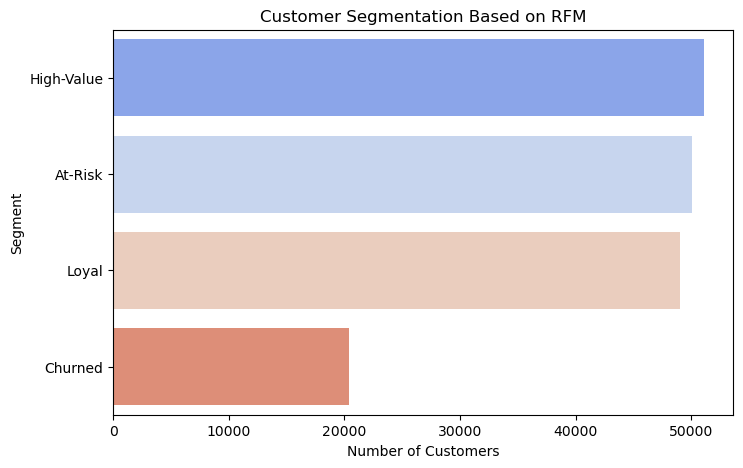

In [76]:
# Visualization: Customer Segments
plt.figure(figsize=(8, 5))
sns.countplot(
    y=rfm["segment"], order=rfm["segment"].value_counts().index, palette="coolwarm"
)
plt.title("Customer Segmentation Based on RFM")
plt.xlabel("Number of Customers")
plt.ylabel("Segment")
plt.show()


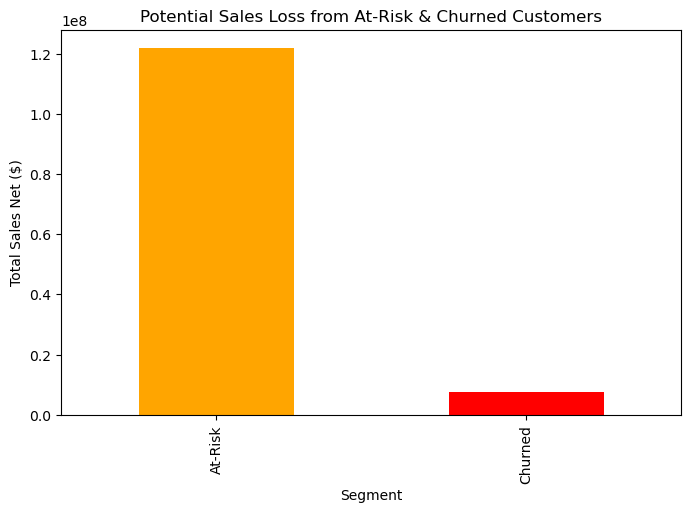

In [77]:
# Visualization: Monetary Contribution of At-Risk & Churned Segments
plt.figure(figsize=(8, 5))
rfm.groupby("segment")["monetary"].sum().loc[["At-Risk", "Churned"]].plot(
    kind="bar", color=["orange", "red"]
)
plt.title("Potential Sales Loss from At-Risk & Churned Customers")
plt.xlabel("Segment")
plt.ylabel("Total Sales Net ($)")
plt.show()


# Method 1 

Estimate sales for 2020 based on previous sales

In [78]:
# Calculate each customer's first and last purchase date
customer_activity = (
    df.groupby("client_id")
    .agg(
        first_purchase=("date_order", "min"),
        last_purchase=("date_order", "max"),
        total_frequency=("client_id", "count"),  # Total transactions
        total_monetary=("sales_net", "sum"),  # Total net sales
    )
    .reset_index()
)


In [79]:
customer_activity

,client_id,first_purchase,last_purchase,total_frequency,total_monetary
0,6,2017-10-27,2019-08-13,40,5.882233e+03
1,7,2018-07-16,2018-12-24,15,1.190777e+03
2,14,2017-09-25,2019-09-20,12762,3.103187e+06
3,18,2017-09-26,2019-09-12,2224,2.194882e+05
4,25,2018-10-10,2018-10-10,4,3.745861e+02
...,...,...,...,...,...
170584,2274456,2019-08-26,2019-09-02,22,1.542821e+03
170585,2274479,2017-10-30,2019-02-27,10,4.186966e+02
170586,2274504,2017-11-02,2019-01-01,4,1.132566e+02
170587,2274508,2017-10-18,2017-10-18,8,0.000000e+00


In [80]:
# Compute each customer’s active period in days
customer_activity["active_days"] = (
    customer_activity["last_purchase"] - customer_activity["first_purchase"]
).dt.days
customer_activity["active_days"] = customer_activity["active_days"].replace(
    0, 1
)  # Avoid division by zero


In [81]:
# **Fix: Apply a minimum observation window (e.g., 30 days)**
customer_activity["adjusted_active_days"] = np.maximum(
    customer_activity["active_days"], 30
)


In [91]:
# Compute yearly frequency for each customer
customer_activity["frequency_per_year"] = (
    customer_activity["total_frequency"] / customer_activity["adjusted_active_days"]
) * 365


In [93]:
predicted_churners = pd.read_excel("churned_clients.xlsx")


In [94]:
# Merge with predicted churners
predicted_churners = predicted_churners.merge(
    customer_activity, on="client_id", how="left"
)


In [95]:
predicted_churners

,client_id,first_purchase,last_purchase,total_frequency,total_monetary,active_days,adjusted_active_days,frequency_per_year
0,37,2017-11-14,2019-06-05,59,6591.136213,568,568,37.913732
1,43,2019-05-22,2019-05-22,1,99.553200,1,30,12.166667
2,60,2019-03-15,2019-03-19,7,0.000000,4,30,85.166667
3,68,2018-12-19,2019-07-26,83,12761.167249,219,219,138.333333
4,76,2018-10-23,2019-04-01,9,1068.572640,160,160,20.531250
...,...,...,...,...,...,...,...,...
36265,2274184,2017-11-29,2019-07-10,203,19364.110639,588,588,126.011905
36266,2274415,2019-02-04,2019-02-04,1,385.326667,1,30,12.166667
36267,2274425,2017-12-28,2019-02-07,4,179.193000,406,406,3.596059
36268,2274479,2017-10-30,2019-02-27,10,418.696600,485,485,7.525773


In [96]:
# Compute expected sales for 2020 using the refined Method 1 formula
predicted_churners["expected_sales_2020_method1"] = (
    predicted_churners["total_monetary"] / predicted_churners["total_frequency"]
) * predicted_churners["frequency_per_year"]


In [97]:
# Handle cases where frequency is zero to prevent division by zero
predicted_churners["expected_sales_2020_method1"].replace(
    [np.inf, -np.inf], 0, inplace=True
)
predicted_churners["expected_sales_2020_method1"] = predicted_churners[
    "expected_sales_2020_method1"
].fillna(0)  # Replace NaN values


C:\Users\ameya\AppData\Local\Temp\ipykernel_42784\4144634974.py:2: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  predicted_churners["expected_sales_2020_method1"].replace(


In [98]:
predicted_churners

,client_id,first_purchase,last_purchase,total_frequency,total_monetary,active_days,adjusted_active_days,frequency_per_year,expected_sales_2020_method1
0,37,2017-11-14,2019-06-05,59,6591.136213,568,568,37.913732,4235.501263
1,43,2019-05-22,2019-05-22,1,99.553200,1,30,12.166667,1211.230600
2,60,2019-03-15,2019-03-19,7,0.000000,4,30,85.166667,0.000000
3,68,2018-12-19,2019-07-26,83,12761.167249,219,219,138.333333,21268.612082
4,76,2018-10-23,2019-04-01,9,1068.572640,160,160,20.531250,2437.681335
...,...,...,...,...,...,...,...,...,...
36265,2274184,2017-11-29,2019-07-10,203,19364.110639,588,588,126.011905,12020.238747
36266,2274415,2019-02-04,2019-02-04,1,385.326667,1,30,12.166667,4688.141111
36267,2274425,2017-12-28,2019-02-07,4,179.193000,406,406,3.596059,161.097155
36268,2274479,2017-10-30,2019-02-27,10,418.696600,485,485,7.525773,315.101565


In [103]:
predicted_churners["total_monetary"].sum()

np.float64(388323280.0497719)

In [99]:
predicted_churners["expected_sales_2020_method1"].value_counts()

expected_sales_2020_method1
 0.000000e+00    612
 8.644937e-14     14
 1.728987e-13     12
-1.728987e-13     11
-6.915949e-13     10
                ... 
 1.202024e+04      1
 4.688141e+03      1
 1.610972e+02      1
 3.151016e+02      1
 2.364778e+03      1
Name: count, Length: 35379, dtype: int64

In [100]:
predicted_churners["expected_sales_2020_method1"].describe()

count    3.627000e+04
mean     1.354797e+04
std      7.735592e+04
min     -1.914136e+03
25%      9.460583e+02
50%      2.470893e+03
75%      7.200682e+03
max      6.499314e+06
Name: expected_sales_2020_method1, dtype: float64

In [101]:
predicted_churners["expected_sales_2020_method1"].sum()

np.float64(491384724.99797624)

In [102]:
predicted_churners[["client_id", "expected_sales_2020_method1"]].to_csv(
    "predicted_churners_sales_method1.csv", index=False
)

In [ ]:
from sklearn.linear_model import LinearRegression

In [20]:
# Calculate each customer's first purchase date
rfm["first_order_date"] = (
    df.groupby("client_id")["date_order"].min().reset_index()["date_order"]
)


In [21]:
# Compute customer tenure (days active in dataset)
rfm["tenure_days"] = (reference_date - rfm["first_order_date"]).dt.days
rfm["tenure_years"] = rfm["tenure_days"] / 365


In [22]:
# Normalize frequency to yearly scale based on tenure
rfm["frequency_per_year"] = rfm["frequency"] / rfm["tenure_years"]
rfm["frequency_per_year"] = rfm["frequency_per_year"].fillna(0)  # Handle NaN values


In [25]:
# Compute expected sales based on normalized frequency
rfm["expected_sales_2020"] = (rfm["monetary"] / rfm["frequency"]) * rfm[
    "frequency_per_year"
]
rfm["expected_sales_2020"] = np.where(
    rfm["expected_sales_2020"] < 0, 0, rfm["expected_sales_2020"]
)  # No negative sales


In [26]:
# Create a dataset for trend analysis (monthly sales per customer)
df["year_month"] = df["date_order"].dt.to_period("M")
monthly_sales = df.groupby(["client_id", "year_month"])["sales_net"].sum().reset_index()

In [27]:
# Convert period to datetime for regression
monthly_sales["year_month"] = monthly_sales["year_month"].astype(str)
monthly_sales["year_month"] = pd.to_datetime(monthly_sales["year_month"])


In [28]:
# Apply Linear Regression to forecast future sales trend per customer
def forecast_sales(client_id):
    client_data = monthly_sales[monthly_sales["client_id"] == client_id]

    if len(client_data) < 3:  # Not enough data points to fit a trend
        return np.nan

    client_data["months_since_start"] = (
        client_data["year_month"] - client_data["year_month"].min()
    ).dt.days / 30.0
    X = client_data[["months_since_start"]].values.reshape(-1, 1)
    y = client_data["sales_net"].values.reshape(-1, 1)

    # Train linear regression model
    model = LinearRegression()
    model.fit(X, y)

    # Predict sales for the next 12 months (2020)
    future_months = np.array(
        [
            (reference_date - client_data["year_month"].min()).days / 30 + i
            for i in range(1, 13)
        ]
    ).reshape(-1, 1)
    future_sales_pred = model.predict(future_months)

    return np.sum(np.maximum(future_sales_pred, 0))  # Sum positive values only


In [29]:
# Apply forecasting to all clients
rfm["trend_adjusted_sales_2020"] = rfm["client_id"].apply(forecast_sales)


C:\Users\ameya\AppData\Local\Temp\ipykernel_31596\1643999753.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  client_data["months_since_start"] = (
C:\Users\ameya\AppData\Local\Temp\ipykernel_31596\1643999753.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  client_data["months_since_start"] = (
C:\Users\ameya\AppData\Local\Temp\ipykernel_31596\1643999753.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value ins

KeyboardInterrupt: 